In [2]:


# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
pd.set_option('display.max_columns', None)
import warnings
warnings.filterwarnings("ignore")
from sklearn.model_selection import train_test_split
from sklearn.ensemble import *
from sklearn.metrics import *

from collections import Counter

# Load data using the full path from Google Drive
data_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/241-CoE540-551-Project_Dynamic_Analysis_Dataset2.ipynb'
# Assuming the file is a CSV, you would use pd.read_csv to load it:
# df = pd.read_csv(data_path)
# Adjust the reading method if it's not a CSV file.

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [3]:
# prompt: create a csv file named RansomwareData_with_perfect_header.csv with a first row with column name ID, Label, Ransomware Family, 1 to 30967

import csv

header = ['ID', 'Label', 'Ransomware Family'] + list(range(1, 30968))

with open('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData_with_perfect_header.csv', 'w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(header)

# Assuming you have the 'RansomwareData.csv' and 'RansomwareData_with_perfect_header.csv' files in your Google Drive

with open('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData.csv', 'r') as infile, \
     open('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData_with_perfect_header.csv', 'a', newline='') as outfile:

  reader = csv.reader(infile)
  writer = csv.writer(outfile)

  # Skip the header row in the input file (if it has one)
  #next(reader, None)

  # Iterate through the rows of the input file and append them to the output file
  for row in reader:
    writer.writerow(row)

In [4]:
df=pd.read_csv("/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData_with_perfect_header.csv",sep=',')
df.head()

,ID,Label,Ransomware Family,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016

In [ ]:
# Total records
print(df.shape[0])

1524


In [ ]:
df.describe()

,ID,Label,Ransomware Family,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016

In [ ]:
df.isnull().sum()

,0
ID,0
Label,0
Ransomware Family,0
1,0
2,0
...,...
30963,0
30964,0
30965,0
30966,0


In [ ]:
df.Label.value_counts() #1 means ransomware, 0 means goodware

,count
Label,
0,942
1,582


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1524 entries, 0 to 1523
Columns: 30970 entries, ID to 30967
dtypes: int64(30970)
memory usage: 360.1 MB


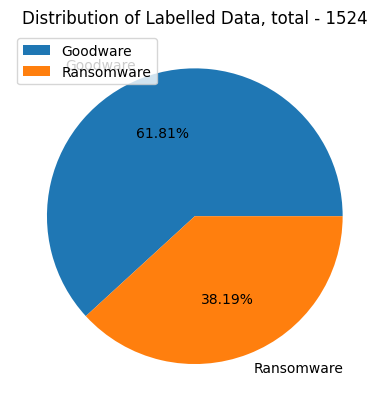

In [ ]:
plt.pie(df.Label.value_counts().values.tolist(), labels=['Goodware','Ransomware'], autopct='%.2f%%')
plt.legend()
plt.title(f"Distribution of Labelled Data, total - {len(df)}")
plt.show()

In [ ]:
df.head()

,ID,Label,Ransomware Family,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016

In [ ]:
df.ID.nunique()

1524

In [ ]:
df.ID.isnull().sum()

0

In [ ]:
df.head()

,ID,Label,Ransomware Family,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232,233,234,235,236,237,238,239,240,241,242,243,244,245,246,247,248,249,250,251,252,253,254,255,256,257,258,259,260,261,262,263,264,265,266,267,268,269,270,271,272,273,274,275,276,277,278,279,280,281,282,283,284,285,286,287,288,289,290,291,292,293,294,295,296,297,298,299,300,301,302,303,304,305,306,307,308,309,310,311,312,313,314,315,316,317,318,319,320,321,322,323,324,325,326,327,328,329,330,331,332,333,334,335,336,337,338,339,340,341,342,343,344,345,346,347,348,349,350,351,352,353,354,355,356,357,358,359,360,361,362,363,364,365,366,367,368,369,370,371,372,373,374,375,376,377,378,379,380,381,382,383,384,385,386,387,388,389,390,391,392,393,394,395,396,397,398,399,400,401,402,403,404,405,406,407,408,409,410,411,412,413,414,415,416,417,418,419,420,421,422,423,424,425,426,427,428,429,430,431,432,433,434,435,436,437,438,439,440,441,442,443,444,445,446,447,448,449,450,451,452,453,454,455,456,457,458,459,460,461,462,463,464,465,466,467,468,469,470,471,472,473,474,475,476,477,478,479,480,481,482,483,484,485,486,487,488,489,490,491,492,493,494,495,496,497,498,499,500,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,854,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016

In [ ]:
# Correlation b/w independent columns/attributes
sns.heatmap(df.drop(['ID','Label','Ransomware Family'], axis=1).corr())
plt.show()

**I have separated the dynamic behaviors in seperate csv files (Do not run these blocks)**

In [ ]:
# prompt: create the following  csv files in the same directory where the RansomwareData_with_perfect_header.csv is saved
# the csv files name
# API_1_232.csv that will contain the column names (ID, Label, Ransomware Family and '1' to '232') from df and the header columns will be same as df
string_list = [str(i) for i in range(1, 233)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_api_1_232 = df[header]

# Specify the path where you want to save the CSV file
api_1_232_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/API_1_232.csv'

# Save the DataFrame to a CSV file
df_api_1_232.to_csv(api_1_232_path, index=False)


In [ ]:
# prompt: create the following  csv files in the same directory where the RansomwareData_with_perfect_header.csv is saved
# the csv files name
# DROP_233_578.csv that will contain the column names (ID, Label, Ransomware Family and '233' to '578') from df and the header columns will be same as df
string_list = [str(i) for i in range(233,578)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_DROP_233_578 = df[header]

# Specify the path where you want to save the CSV file
DROP_233_578_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/DROP_233_578.csv'

# Save the DataFrame to a CSV file
df_DROP_233_578.to_csv(DROP_233_578_path, index=False)

In [ ]:
# REG_DELETED_579_721.csv that will contain the column names (ID, Label, Ransomware Family and '579' to '721') from df and the header columns will be same as df
string_list = [str(i) for i in range(579,721)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_REG_DELETED_579_721 = df[header]

# Specify the path where you want to save the CSV file
REG_DELETED_579_721_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/REG_DELETED_579_721.csv'

# Save the DataFrame to a CSV file
df_REG_DELETED_579_721.to_csv(REG_DELETED_579_721_path, index=False)

In [ ]:
# REG_OPENED_722_3380.csv that will contain the column names (ID, Label, Ransomware Family and '579' to '721') from df and the header columns will be same as df
string_list = [str(i) for i in range(722,3380)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_REG_OPENED_722_3380 = df[header]

# Specify the path where you want to save the CSV file
REG_OPENED_722_3380_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/REG_OPENED_722_3380.csv'

# Save the DataFrame to a CSV file
df_REG_OPENED_722_3380.to_csv(REG_OPENED_722_3380_path, index=False)

In [ ]:
string_list = [str(i) for i in range(3381,5720)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_REG_READ_3381_5720 = df[header]

# Specify the path where you want to save the CSV file
REG_READ_3381_5720_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/REG_READ_3381_5720.csv'

# Save the DataFrame to a CSV file
df_REG_READ_3381_5720.to_csv(REG_READ_3381_5720_path, index=False)

In [ ]:
string_list = [str(i) for i in range(5721,7200)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_REG_WRITTEN_5721_7200 = df[header]

# Specify the path where you want to save the CSV file
REG_WRITTEN_5721_7200_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/REG_WRITTEN_5721_7200.csv'

# Save the DataFrame to a CSV file
df_REG_WRITTEN_5721_7200.to_csv(REG_WRITTEN_5721_7200_path, index=False)

In [ ]:

string_list = [str(i) for i in range(7201,7316)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_DELETED_7201_7316 = df[header]

# Specify the path where you want to save the CSV file
FILES_DELETED_7201_7316_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_DELETED_7201_7316.csv'

# Save the DataFrame to a CSV file
df_FILES_DELETED_7201_7316.to_csv(FILES_DELETED_7201_7316_path, index=False)

In [ ]:

string_list = [str(i) for i in range(7317,9220)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_OPENED_7317_9220 = df[header]

# Specify the path where you want to save the CSV file
FILES_OPENED_7317_9220_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_OPENED_7317_9220.csv'

# Save the DataFrame to a CSV file
df_FILES_OPENED_7317_9220.to_csv(FILES_OPENED_7317_9220_path, index=False)

In [ ]:

string_list = [str(i) for i in range(9221,9669)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_READ_9221_9669 = df[header]

# Specify the path where you want to save the CSV file
FILES_READ_9221_9669_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_READ_9221_9669.csv'

# Save the DataFrame to a CSV file
df_FILES_READ_9221_9669.to_csv(FILES_READ_9221_9669_path, index=False)

In [ ]:

string_list = [str(i) for i in range(9670,11341)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_WRITTEN_9670_11341 = df[header]

# Specify the path where you want to save the CSV file
FILES_WRITTEN_9670_11341_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_WRITTEN_9670_11341.csv'

# Save the DataFrame to a CSV file
df_FILES_WRITTEN_9670_11341.to_csv(FILES_WRITTEN_9670_11341_path, index=False)

In [ ]:

string_list = [str(i) for i in range(11342,11397)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_EXT_DELETED_11342_11397 = df[header]

# Specify the path where you want to save the CSV file
FILES_EXT_DELETED_11342_11397_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_EXT_DELETED_11342_11397.csv'

# Save the DataFrame to a CSV file
df_FILES_EXT_DELETED_11342_11397.to_csv(FILES_EXT_DELETED_11342_11397_path, index=False)

In [ ]:

string_list = [str(i) for i in range(11398,11834)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_EXT_OPENED_11398_11834 = df[header]

# Specify the path where you want to save the CSV file
FILES_EXT_OPENED_11398_11834_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_EXT_OPENED_11398_11834.csv'

# Save the DataFrame to a CSV file
df_FILES_EXT_OPENED_11398_11834.to_csv(FILES_EXT_OPENED_11398_11834_path, index=False)

In [ ]:

string_list = [str(i) for i in range(11835,11951)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_EXT_READ_11835_11951 = df[header]

# Specify the path where you want to save the CSV file
FILES_EXT_READ_11835_11951_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_EXT_READ_11835_11951.csv'

# Save the DataFrame to a CSV file
df_FILES_EXT_READ_11835_11951.to_csv(FILES_EXT_READ_11835_11951_path, index=False)

In [ ]:

string_list = [str(i) for i in range(11952,12276)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_FILES_EXT_WRITTEN_11952_12276 = df[header]

# Specify the path where you want to save the CSV file
FILES_EXT_WRITTEN_11952_12276_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/FILES_EXT_WRITTEN_11952_12276.csv'

# Save the DataFrame to a CSV file
df_FILES_EXT_WRITTEN_11952_12276.to_csv(FILES_EXT_WRITTEN_11952_12276_path, index=False)

In [ ]:

string_list = [str(i) for i in range(12277,12994)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_DIR_CREATED_12277_12994 = df[header]

# Specify the path where you want to save the CSV file
DIR_CREATED_12277_12994_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/DIR_CREATED_12277_12994.csv'

# Save the DataFrame to a CSV file
df_DIR_CREATED_12277_12994.to_csv(DIR_CREATED_12277_12994_path, index=False)

In [ ]:
string_list = [str(i) for i in range(12995,14700)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_DIR_ENUMERATED_12995_14700 = df[header]

# Specify the path where you want to save the CSV file
DIR_ENUMERATED_12995_14700_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/DIR_ENUMERATED_12995_14700.csv'

# Save the DataFrame to a CSV file
df_DIR_ENUMERATED_12995_14700.to_csv(DIR_ENUMERATED_12995_14700_path, index=False)

In [ ]:

string_list = [str(i) for i in range(14701,30967)]

# Concatenate the header with the string list
header = ['ID', 'Label', 'Ransomware Family'] + string_list
# Assuming df is your DataFrame
df_STR_14701_30967 = df[header]

# Specify the path where you want to save the CSV file
STR_14701_30967_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/STR_14701_30967.csv'

# Save the DataFrame to a CSV file
df_STR_14701_30967.to_csv(STR_14701_30967_path, index=False)

**I will analyse the API behaviors (API_1_232.csv) First (Features selection)**

In [ ]:
API_df=pd.read_csv("/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/API_1_232.csv",sep=',')
API_df.head()

,ID,Label,Ransomware Family,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49,50,51,52,53,54,55,56,57,58,59,60,61,62,63,64,65,66,67,68,69,70,71,72,73,74,75,76,77,78,79,80,81,82,83,84,85,86,87,88,89,90,91,92,93,94,95,96,97,98,99,100,101,102,103,104,105,106,107,108,109,110,111,112,113,114,115,116,117,118,119,120,121,122,123,124,125,126,127,128,129,130,131,132,133,134,135,136,137,138,139,140,141,142,143,144,145,146,147,148,149,150,151,152,153,154,155,156,157,158,159,160,161,162,163,164,165,166,167,168,169,170,171,172,173,174,175,176,177,178,179,180,181,182,183,184,185,186,187,188,189,190,191,192,193,194,195,196,197,198,199,200,201,202,203,204,205,206,207,208,209,210,211,212,213,214,215,216,217,218,219,220,221,222,223,224,225,226,227,228,229,230,231,232
0,10001,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0
1,10002,1,3,1,0,1,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,1,1,0,0,0,1,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,1,0,1,1,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,1,1,0,0,1,0
2,10003,1,2,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,1,0
3,10005,1,5,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,1,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0
4,10006,1,7,1,0,1,0,0,1,1,0,1,0,0,0,1,1,0,1,0,0,0,0,0,1,1,0,0,0,0,1,1,0,0,1,1,0,0,1,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,1,1,1,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,1,0,1,0,0,1,0,1,1,0,1,0,1,1,0,1,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,1,1,1,1,0,1,1,1,0,0,1,1,1,0,1,0,0,1,0,0,0,0,0,0,1,0,0,0,0,1,1,0,0,1,1,1,0,1,1,1,1,1,1,0,1,1,1,0,0,0,1,0,1,1,1,0,1,0,0,1,1,0,1,1,0,0,0,0,0,1,0,0,0,1,0,1,0,1,0,0,0,1,1,0,1,0,0,1,0,1,1,0,0,1,0,0,1,0,0,1,0,1,0,1,1,1,0,1,0


**Feature Selection Mechanism**

**Show the Highly Coorelated features through Pearson Correlation Matrix**

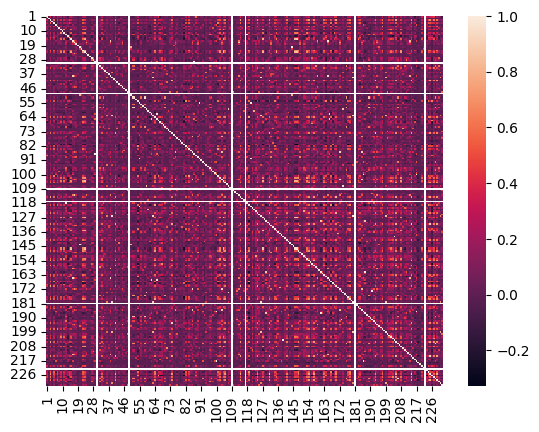

In [ ]:
# Correlation b/w independent columns/attributes in API behaviors
sns.heatmap(API_df.drop(['ID','Label','Ransomware Family'], axis=1).corr())
plt.show()

In [ ]:
# Create correlation matrix
corr_matrix = API_df.drop(['ID','Label','Ransomware Family'], axis=1).corr().abs() # Includes negative correlation as well

# Select upper triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

# Find features with correlation greater than 0.95
to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

print(to_drop)

['58', '87', '90', '118', '120', '126', '144', '165', '166', '180', '186', '187', '191', '204', '214', '217', '228']


In [ ]:
# Drop features
API_df.drop(to_drop, axis=1, inplace=True)

<Axes: >

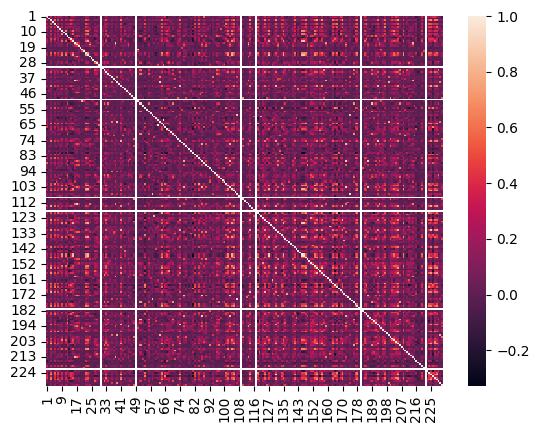

In [ ]:
sns.heatmap(API_df.drop(['ID','Label','Ransomware Family'], axis=1).corr())

In [ ]:
def iv_woe(data, target, bins=10, show_woe=False):
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()

    #Extract Column Names
    cols = data.columns

    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], bins,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y': data[target]})
        else:
            d0 = pd.DataFrame({'x': data[ivars], 'y': data[target]})
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()
        d['Non-Events'] = d['N'] - d['Events']
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0)
        woeDF=pd.concat([woeDF,d], axis=0)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [ ]:
API_df.Label.dtypes

dtype('int64')

In [ ]:
# Get the list of columns to drop
cols_to_drop = to_drop

# Keep only the columns that are in the DataFrame
cols_to_drop = [col for col in cols_to_drop if col in API_df.columns]

# Now drop the columns that are present
iv, woe = iv_woe(API_df.drop(cols_to_drop, axis=1), 'Label')

Information value of ID is 10.280079
Information value of Ransomware Family is 5.423898
Information value of 1 is 0.012501
Information value of 2 is 0.00813
Information value of 3 is 0.289752
Information value of 4 is 0.010538
Information value of 5 is 0.399391
Information value of 6 is 0.075005
Information value of 7 is 1.38398
Information value of 8 is 0.106107
Information value of 9 is 0.420586
Information value of 10 is 0.001398
Information value of 11 is 0.459798
Information value of 12 is 0.040912
Information value of 13 is 0.114396
Information value of 14 is 0.016954
Information value of 15 is 0.162157
Information value of 16 is 0.023369
Information value of 17 is 0.006226
Information value of 18 is 0.004109
Information value of 19 is 0.006484
Information value of 20 is 0.001686
Information value of 21 is 0.000634
Information value of 22 is 1.022692
Information value of 23 is 0.545584
Information value of 24 is 0.032197
Information value of 25 is 0.013003
Information value of 26

In [ ]:
iv.sort_values(by = 'IV', ascending=True)

,Variable,IV
0,117,0.000000
0,30,0.000000
0,181,0.000000
0,222,0.000000
0,49,0.000000
...,...,...
0,64,1.414907
0,167,1.685882
0,119,3.124256
0,Ransomware Family,5.423898


**Select those Variables whose 0.01 <IV <1 and show the count**

In [ ]:
# Filter for variables with 0 < IV <= 1.3
filtered_iv = iv[(iv['IV'] >0) & (iv['IV'] <1)]

# Display the filtered variables and their IV values
print(filtered_iv.sort_values(by = 'IV', ascending=True))
# Show the count of variables meeting the criteria
count = len(filtered_iv)
print("\nNumber of variables with 0 < IV < 1:", count)

# Display the sorted DataFrame
filtered_iv = filtered_iv.sort_values(by = 'IV', ascending=True)['Variable'][:count].values.tolist()
features = filtered_iv

print(features,'\n')
print('Total number of features-\n',len(features))

   Variable            IV
0        59  8.783776e-08
0        86  2.176100e-06
0       174  3.449217e-05
0        78  4.397154e-05
0        40  4.397154e-05
..      ...           ...
0       197  7.532789e-01
0        82  7.949645e-01
0        27  8.462817e-01
0       226  9.065256e-01
0       101  9.325605e-01

[201 rows x 2 columns]

Number of variables with 0 < IV < 1: 201
['59', '86', '174', '78', '40', '132', '44', '45', '111', '231', '196', '206', '112', '57', '42', '103', '192', '176', '21', '107', '185', '83', '193', '10', '72', '106', '219', '155', '55', '94', '133', '20', '89', '139', '47', '36', '53', '26', '80', '39', '18', '199', '173', '97', '17', '151', '158', '221', '19', '169', '136', '77', '2', '175', '137', '50', '63', '159', '172', '71', '4', '122', '198', '207', '75', '213', '116', '74', '194', '1', '35', '25', '113', '223', '209', '232', '95', '179', '14', '183', '150', '160', '37', '145', '201', '140', '60', '16', '203', '70', '128', '195', '73', '215', '152', '14

**Training Machine Learning Model for API features**

In [ ]:
X = API_df[features]
y = API_df['Label']

In [ ]:
randomseed = 42 # Used for replicating the experiment

In [ ]:
X_train, X_test, y_train, y_test = train_test_split(X, y, train_size=0.7, random_state=randomseed)

In [ ]:
print(X_test.shape[0] + X_train.shape[0])
print('Training labels shape:', y_train.shape)
print('Test labels shape:', y_test.shape)
print('Training features shape:', X_train.shape)
print('Test features shape:', X_test.shape)

1524
Training labels shape: (1066,)
Test labels shape: (458,)
Training features shape: (1066, 201)
Test features shape: (458, 201)


In [ ]:
rf = RandomForestClassifier(random_state = randomseed)

In [ ]:
rf.fit(X_train,y_train)

RandomForestClassifier(random_state=42)

In [ ]:
pred = rf.predict(X_test)
pred_proba = rf.predict_proba(X_test)

# Extract probabilities for the positive class (1)
pred_proba = np.array([prob[1] for prob in pred_proba])

In [ ]:
cm = confusion_matrix(y_test,pred)
cm

array([[288,   2],
       [ 18, 150]])

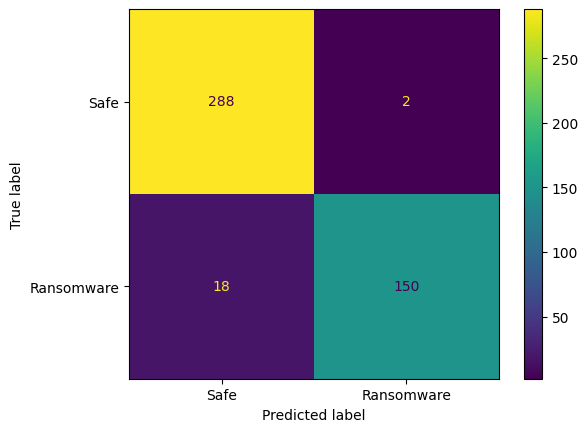

In [ ]:
# Classes
classes = ['Safe', 'Ransomware']

cmd = ConfusionMatrixDisplay(cm, display_labels=classes)
cmd.plot()
plt.show()

In [ ]:
# Extract TP, FP, FN, TN
TP = cm[1, 1]
FP = cm[0, 1]
FN = cm[1, 0]
TN = cm[0, 0]


# Accuracy
accuracy = (TP + TN) / (TP + TN + FP + FN)

# Precision
precision = TP / (TP + FP)

# Recall
recall = TP / (TP + FN)

# F1 Score
f1 = 2 * (precision * recall) / (precision + recall)

# Matthews Correlation Coefficient (MCC)
mcc = (TP * TN - FP * FN) / np.sqrt((TP + FP) * (TP + FN) * (TN + FP) * (TN + FN))

# False Positive Rate (FPR)
fpr = FP / (FP + TN)

# Calculate AUC score
auc = roc_auc_score(y_test, pred_proba)

# Print all the metrics
print(f"Accuracy: {accuracy:.4f}")
print(f"Precision: {precision:.4f}")
print(f"Recall: {recall:.4f}")
print(f"F1 Score: {f1:.4f}")
print(f"MCC: {mcc:.4f}")
print(f"False Positive Rate: {fpr:.4f}")
print(f"AUC Score: {auc:.4f}")

Accuracy: 0.9563
Precision: 0.9868
Recall: 0.8929
F1 Score: 0.9375
MCC: 0.9067
False Positive Rate: 0.0069
AUC Score: 0.9853


In [ ]:
# prompt: After confusion matrix which IDs are found as ransomware and which IDs are found as safe show the list with ID, Label and Ransomware Family

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) but the actual label was safe (0) - False Positives (FP)
fp_indices = np.where((y_test == 0) & (pred == 1))[0]

# Find indices where the model predicted safe (0) but the actual label was ransomware (1) - False Negatives (FN)
fn_indices = np.where((y_test == 1) & (pred == 0))[0]


# Create lists to store the information
ransomware_found_list = []
safe_found_list = []

# Iterate through the false positives and extract information
for index in fp_indices:
  ransomware_found_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Iterate through the false negatives and extract information
for index in fn_indices:
  safe_found_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Print the lists
print("IDs found as ransomware (False Positives):")
for item in ransomware_found_list:
    print(item)

print("\nIDs found as safe (False Negatives):")
for item in safe_found_list:
    print(item) # Added indentation here to fix the error

IDs found as ransomware (False Positives):
{'ID': 20772, 'Label': 0, 'Ransomware Family': 0}
{'ID': 21207, 'Label': 0, 'Ransomware Family': 0}

IDs found as safe (False Negatives):
{'ID': 10158, 'Label': 1, 'Ransomware Family': 7}
{'ID': 11028, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10523, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10352, 'Label': 1, 'Ransomware Family': 7}
{'ID': 10251, 'Label': 1, 'Ransomware Family': 4}
{'ID': 10223, 'Label': 1, 'Ransomware Family': 3}
{'ID': 11201, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10737, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10557, 'Label': 1, 'Ransomware Family': 9}
{'ID': 11138, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10532, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10037, 'Label': 1, 'Ransomware Family': 7}
{'ID': 10581, 'Label': 1, 'Ransomware Family': 1}
{'ID': 11183, 'Label': 1, 'Ransomware Family': 4}
{'ID': 10404, 'Label': 1, 'Ransomware Family': 1}
{'ID': 11105, 'Label': 1, 'Ransomware Family': 11}
{'ID': 10498, 'Lab

In [ ]:
# prompt: show the ID, Label, Ransomware Family of True positive Ransomware and Safe

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) and the actual label was ransomware (1) - True Positives (TP)
tp_indices = np.where((y_test == 1) & (pred == 1))[0]

# Find indices where the model predicted safe (0) and the actual label was safe (0) - True Negatives (TN)
tn_indices = np.where((y_test == 0) & (pred == 0))[0]

# Create lists to store the information
true_positive_ransomware_list = []
true_negative_safe_list = []

# Iterate through the true positives and extract information
for index in tp_indices:
  true_positive_ransomware_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Iterate through the true negatives and extract information
for index in tn_indices:
  true_negative_safe_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Print the lists
print("True Positives (Ransomware):")
for item in true_positive_ransomware_list:
    print(item)

print("\nTrue Negatives (Safe):")
for item in true_negative_safe_list:
    print(item) # Added indentation to print each item in the loop

True Positives (Ransomware):
{'ID': 10158, 'Label': 1, 'Ransomware Family': 7}
{'ID': 10831, 'Label': 1, 'Ransomware Family': 1}
{'ID': 11076, 'Label': 1, 'Ransomware Family': 9}
{'ID': 10064, 'Label': 1, 'Ransomware Family': 3}
{'ID': 10111, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10490, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10899, 'Label': 1, 'Ransomware Family': 5}
{'ID': 10729, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10268, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10148, 'Label': 1, 'Ransomware Family': 6}
{'ID': 11160, 'Label': 1, 'Ransomware Family': 9}
{'ID': 10702, 'Label': 1, 'Ransomware Family': 5}
{'ID': 11007, 'Label': 1, 'Ransomware Family': 11}
{'ID': 11187, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10732, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10527, 'Label': 1, 'Ransomware Family': 9}
{'ID': 10131, 'Label': 1, 'Ransomware Family': 2}
{'ID': 10785, 'Label': 1, 'Ransomware Family': 6}
{'ID': 10616, 'Label': 1, 'Ransomware Family': 6}
{'ID': 10666, 'Label

In [ ]:
# prompt: show the True Positives table format.

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) and the actual label was ransomware (1) - True Positives (TP)
tp_indices = np.where((y_test == 1) & (pred == 1))[0]

# Create a list to store the information
true_positive_ransomware_list = []

# Iterate through the true positives and extract information
for index in tp_indices:
  true_positive_ransomware_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Print the list in a table format using pandas
tp_df = pd.DataFrame(true_positive_ransomware_list)
print("True Positives (Ransomware):")
tp_df

True Positives (Ransomware):


,ID,Label,Ransomware Family
0,10158,1,7
1,10831,1,1
2,11076,1,9
3,10064,1,3
4,10111,1,5
...,...,...,...
148,10536,1,4
149,10610,1,9
150,11134,1,7
151,10795,1,9


from matplotlib import pyplot as plt
tp_df['ID'].plot(kind='hist', bins=20, title='ID')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
tp_df['Ransomware Family'].plot(kind='hist', bins=20, title='Ransomware Family')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
tp_df.plot(kind='scatter', x='ID', y='Ransomware Family', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Label']
  ys = series['ID']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = tp_df.sort_values('Label', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Label')
_ = plt.ylabel('ID')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  xs = series['Label']
  ys = series['Ransomware Family']
  
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = tp_df.sort_values('Label', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Label')
_ = plt.ylabel('Ransomware Family')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['Label']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'Label'}, axis=1)
              .sort_values('Label', ascending=True))
  xs = counted['Label']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = tp_df.sort_values('Label', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Label')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
tp_df['ID'].plot(kind='line', figsize=(8, 4), title='ID')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
tp_df['Ransomware Family'].plot(kind='line', figsize=(8, 4), title='Ransomware Family')
plt.gca().spines[['top', 'right']].set_visible(False)

In [ ]:
# prompt: show the true negatives in a table

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted safe (0) and the actual label was safe (0) - True Negatives (TN)
tn_indices = np.where((y_test == 0) & (pred == 0))[0]

# Create a list to store the information
true_negative_safe_list = []

# Iterate through the true negatives and extract information
for index in tn_indices:
  true_negative_safe_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Print the list in a table format using pandas
tn_df = pd.DataFrame(true_negative_safe_list)
print("True Negatives (Safe):")
tn_df

True Negatives (Safe):


,ID,Label,Ransomware Family
0,20262,0,0
1,20588,0,0
2,21097,0,0
3,20359,0,0
4,20702,0,0
...,...,...,...
282,21092,0,0
283,20710,0,0
284,21032,0,0
285,20527,0,0


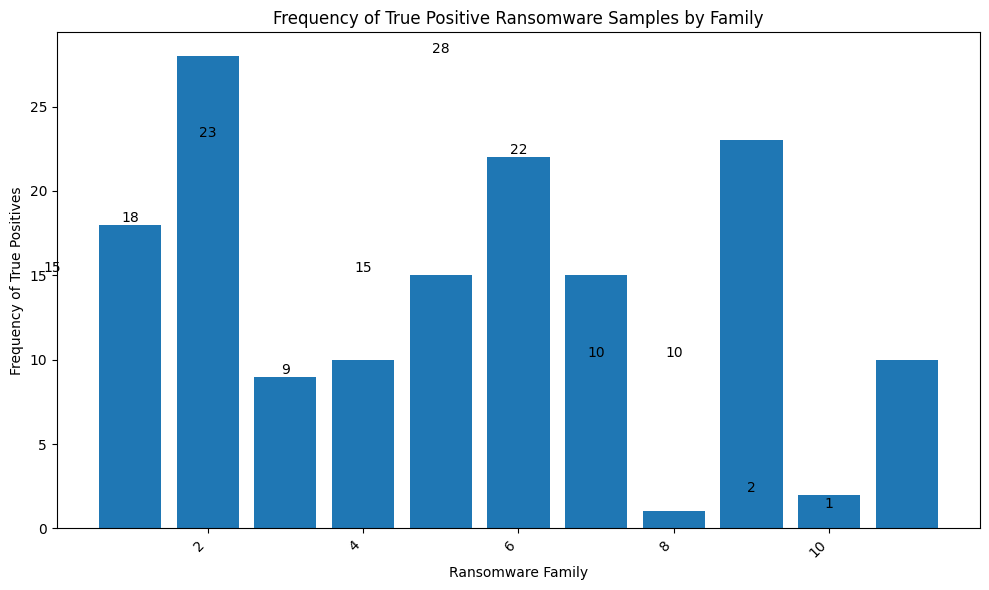

In [ ]:
# prompt: show the Frequency of True positive Ransomware sample with Ransomware Family  in a bar chart. show number in the lables

from collections import Counter

# Assuming true_positive_ransomware_list is defined as in the previous code
ransomware_family_counts = Counter([item['Ransomware Family'] for item in true_positive_ransomware_list])

# Create a bar chart
plt.figure(figsize=(10, 6))
plt.bar(ransomware_family_counts.keys(), ransomware_family_counts.values())
plt.xlabel('Ransomware Family')
plt.ylabel('Frequency of True Positives')
plt.title('Frequency of True Positive Ransomware Samples by Family')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

# Add labels above the bars with the count
for i, v in enumerate(ransomware_family_counts.values()):
  plt.text(i, v, str(v), ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [ ]:
# prompt: show the count and Ransomware Family name in a table which are True Positives

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) and the actual label was ransomware (1) - True Positives (TP)
tp_indices = np.where((y_test == 1) & (pred == 1))[0]

# Create a list to store the information
true_positive_ransomware_list = []

# Iterate through the true positives and extract information
for index in tp_indices:
  true_positive_ransomware_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Create a DataFrame from the list
tp_df = pd.DataFrame(true_positive_ransomware_list)

# Group by Ransomware Family and count the occurrences
tp_counts_df = tp_df.groupby('Ransomware Family')['ID'].count().reset_index(name='Count')

# Print the table
print("True Positives (Ransomware) Count by Family:")
tp_counts_df

True Positives (Ransomware) Count by Family:


,Ransomware Family,Count
0,1,18
1,2,28
2,3,9
3,4,9
4,5,14
5,6,22
6,7,14
7,8,1
8,9,23
9,10,2


**Train the model with DT**

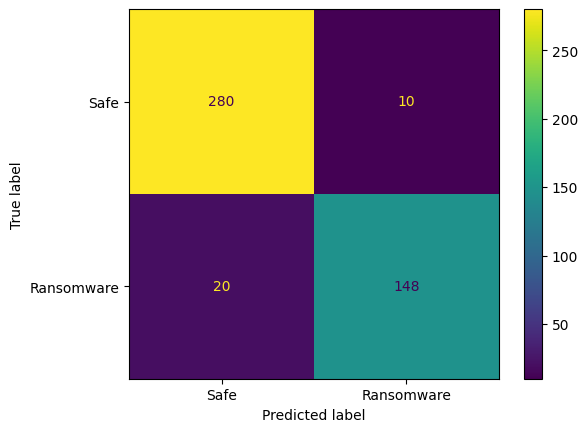

Accuracy (DT): 0.9345
Precision (DT): 0.9367
Recall (DT): 0.8810
F1 Score (DT): 0.9080
MCC (DT): 0.8582
False Positive Rate (DT): 0.0345
AUC Score (DT): 0.9571


In [ ]:
# prompt: train the model with DT for the selected features and show the evaluation metrics

from sklearn.tree import DecisionTreeClassifier

#dt = DecisionTreeClassifier(random_state=randomseed)
dt= DecisionTreeClassifier(max_depth=9, min_samples_split=2, min_samples_leaf=1, random_state=42) # Limit tree depth

dt.fit(X_train, y_train)
pred_dt = dt.predict(X_test)
pred_proba_dt = dt.predict_proba(X_test)

pred_proba_dt = np.array([prob[1] for prob in pred_proba_dt])
cm_dt = confusion_matrix(y_test, pred_dt)

# Confusion Matrix Display
cmd_dt = ConfusionMatrixDisplay(cm_dt, display_labels=classes)
cmd_dt.plot()
plt.show()

# Extract TP, FP, FN, TN
TP_dt = cm_dt[1, 1]
FP_dt = cm_dt[0, 1]
FN_dt = cm_dt[1, 0]
TN_dt = cm_dt[0, 0]

# Accuracy
accuracy_dt = (TP_dt + TN_dt) / (TP_dt + TN_dt + FP_dt + FN_dt)

# Precision
precision_dt = TP_dt / (TP_dt + FP_dt)

# Recall
recall_dt = TP_dt / (TP_dt + FN_dt)

# F1 Score
f1_dt = 2 * (precision_dt * recall_dt) / (precision_dt + recall_dt)

# Matthews Correlation Coefficient (MCC)
mcc_dt = (TP_dt * TN_dt - FP_dt * FN_dt) / np.sqrt((TP_dt + FP_dt) * (TP_dt + FN_dt) * (TN_dt + FP_dt) * (TN_dt + FN_dt))

# False Positive Rate (FPR)
fpr_dt = FP_dt / (FP_dt + TN_dt)

# Calculate AUC score
auc_dt = roc_auc_score(y_test, pred_proba_dt)

# Print all the metrics
print(f"Accuracy (DT): {accuracy_dt:.4f}")
print(f"Precision (DT): {precision_dt:.4f}")
print(f"Recall (DT): {recall_dt:.4f}")
print(f"F1 Score (DT): {f1_dt:.4f}")
print(f"MCC (DT): {mcc_dt:.4f}")
print(f"False Positive Rate (DT): {fpr_dt:.4f}")
print(f"AUC Score (DT): {auc_dt:.4f}")

In [ ]:
# prompt: show the count and Ransomware Family name in a table which are True Positives

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) and the actual label was ransomware (1) - True Positives (TP)
tp_indices = np.where((y_test == 1) & (pred_dt == 1))[0]

# Create a list to store the information
true_positive_ransomware_list = []

# Iterate through the true positives and extract information
for index in tp_indices:
  true_positive_ransomware_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Create a DataFrame from the list
tp_df = pd.DataFrame(true_positive_ransomware_list)

# Group by Ransomware Family and count the occurrences
tp_counts_df = tp_df.groupby('Ransomware Family')['ID'].count().reset_index(name='Count')

# Print the table
print("True Positives (Ransomware) Count by Family:")
tp_counts_df

True Positives (Ransomware) Count by Family:


,Ransomware Family,Count
0,1,18
1,2,27
2,3,8
3,4,9
4,5,16
5,6,21
6,7,13
7,8,1
8,9,23
9,10,2


**Train the model with XGBoost**

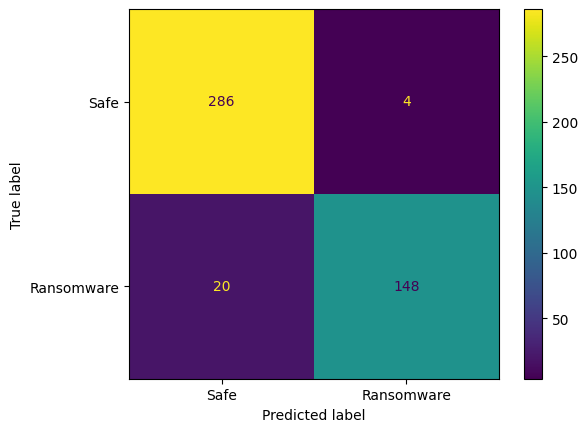

Accuracy (XGBoost): 0.9476
Precision (XGBoost): 0.9737
Recall (XGBoost): 0.8810
F1 Score (XGBoost): 0.9250
MCC (XGBoost): 0.8875
False Positive Rate (XGBoost): 0.0138
AUC Score (XGBoost): 0.9892


In [ ]:
# prompt: train the model with XGBoost for the selected features and show the evaluation metrics

import xgboost as xgb
from sklearn.metrics import roc_auc_score

# Train the XGBoost model
xgb_model = xgb.XGBClassifier(random_state=randomseed)
xgb_model.fit(X_train, y_train)

# Make predictions
pred_xgb = xgb_model.predict(X_test)
pred_proba_xgb = xgb_model.predict_proba(X_test)

# Extract probabilities for the positive class (1)
pred_proba_xgb = np.array([prob[1] for prob in pred_proba_xgb])

# Confusion Matrix
cm_xgb = confusion_matrix(y_test, pred_xgb)
cmd_xgb = ConfusionMatrixDisplay(cm_xgb, display_labels=classes)
cmd_xgb.plot()
plt.show()

# Evaluation Metrics
TP_xgb = cm_xgb[1, 1]
FP_xgb = cm_xgb[0, 1]
FN_xgb = cm_xgb[1, 0]
TN_xgb = cm_xgb[0, 0]

accuracy_xgb = (TP_xgb + TN_xgb) / (TP_xgb + TN_xgb + FP_xgb + FN_xgb)
precision_xgb = TP_xgb / (TP_xgb + FP_xgb)
recall_xgb = TP_xgb / (TP_xgb + FN_xgb)
f1_xgb = 2 * (precision_xgb * recall_xgb) / (precision_xgb + recall_xgb)
mcc_xgb = (TP_xgb * TN_xgb - FP_xgb * FN_xgb) / np.sqrt((TP_xgb + FP_xgb) * (TP_xgb + FN_xgb) * (TN_xgb + FP_xgb) * (TN_xgb + FN_xgb))
fpr_xgb = FP_xgb / (FP_xgb + TN_xgb)
auc_xgb = roc_auc_score(y_test, pred_proba_xgb)


print(f"Accuracy (XGBoost): {accuracy_xgb:.4f}")
print(f"Precision (XGBoost): {precision_xgb:.4f}")
print(f"Recall (XGBoost): {recall_xgb:.4f}")
print(f"F1 Score (XGBoost): {f1_xgb:.4f}")
print(f"MCC (XGBoost): {mcc_xgb:.4f}")
print(f"False Positive Rate (XGBoost): {fpr_xgb:.4f}")
print(f"AUC Score (XGBoost): {auc_xgb:.4f}")

In [ ]:
# prompt: show the count and Ransomware Family name in a table which are True Positives

# Assuming y_test and pred are your true and predicted labels
# Also assuming you have a DataFrame 'API_df' with 'ID', 'Label', 'Ransomware Family' columns

# Find indices where the model predicted ransomware (1) and the actual label was ransomware (1) - True Positives (TP)
tp_indices = np.where((y_test == 1) & (pred_xgb == 1))[0]

# Create a list to store the information
true_positive_ransomware_list = []

# Iterate through the true positives and extract information
for index in tp_indices:
  true_positive_ransomware_list.append({
      'ID': API_df['ID'].iloc[X_test.index[index]],
      'Label': API_df['Label'].iloc[X_test.index[index]],
      'Ransomware Family': API_df['Ransomware Family'].iloc[X_test.index[index]]
  })

# Create a DataFrame from the list
tp_df = pd.DataFrame(true_positive_ransomware_list)

# Group by Ransomware Family and count the occurrences
tp_counts_df = tp_df.groupby('Ransomware Family')['ID'].count().reset_index(name='Count')

# Print the table
print("True Positives (Ransomware) Count by Family:")
tp_counts_df

True Positives (Ransomware) Count by Family:


,Ransomware Family,Count
0,1,18
1,2,28
2,3,8
3,4,9
4,5,15
5,6,21
6,7,14
7,8,1
8,9,22
9,10,2


In [ ]:
# prompt: read every csv file in different data frame variable except these csv files (RansomwareData.csv, RansomwareData_with_perfect_header.csv, RansomwareData_with_header.csv)

import pandas as pd
import os

# Specify the directory where your CSV files are located
directory = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/'

# Create an empty dictionary to store the DataFrames
dataframes = {}

# Iterate through all the files in the directory
for filename in os.listdir(directory):
  if filename.endswith('.csv') and filename not in ('RansomwareData.csv', 'RansomwareData_with_perfect_header.csv', 'RansomwareData_with_header.csv'):
    filepath = os.path.join(directory, filename)
    df_name = filename[:-4]  # Remove the .csv extension
    dataframes[df_name] = pd.read_csv(filepath)

# Now you can access the DataFrames using the dictionary:
# Example: df_API_1_232 = dataframes['API_1_232']

In [ ]:
import pandas as pd
import os
!pip install xlsxwriter
import xlsxwriter # Import the necessary module

# Specify the directory where your CSV files are located
directory = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/'

# Create an empty dictionary to store the DataFrames
dataframes = {}

# Iterate through all the files in the directory
for filename in os.listdir(directory):
  if filename.endswith('.csv') and filename not in ('RansomwareData.csv', 'RansomwareData_with_perfect_header.csv', 'RansomwareData_with_header.csv'):
    filepath = os.path.join(directory, filename)
    df_name = filename[:-4]  # Remove the .csv extension
    dataframes[df_name] = pd.read_csv(filepath)

# Now you can access the DataFrames using the dictionary:
# Example: df_API_1_232 = dataframes['API_1_232']

def select_features(df, target_col='Label', threshold=0.1):
  """
  Selects relevant features for a given DataFrame using Pearson correlation and IV/WoE.

  Args:
    df: The DataFrame to process.
    target_col: The name of the target variable column.
    threshold: The minimum IV value for a feature to be considered relevant.

  Returns:
    A list of selected feature names.
  """
  df_features = df.drop(['ID', 'Label', 'Ransomware Family'], axis=1)
  corr_matrix = df_features.corr().abs()
  upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
  to_drop = [column for column in upper.columns if any(upper[column] > 0.95)]

  df_features = df_features.drop(to_drop, axis=1)
  iv, woe = iv_woe(df.drop(['ID', 'Ransomware Family'] + to_drop, axis=1), 'Label')
  features = iv.sort_values(by='IV', ascending=False)['Variable'][
      iv.IV > threshold].values.tolist()
  return features


# Initialize an ExcelWriter object
writer = pd.ExcelWriter('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/selected_features.xlsx', engine='xlsxwriter')

# Process each DataFrame
for df_name, df in dataframes.items():
  selected_features = select_features(df)
  print(f"DataFrame: {df_name}")
  print("Number of selected features:", len(selected_features))
  print("Selected features:", selected_features)
  # Create a DataFrame with the selected features
  selected_features_df = pd.DataFrame({'Feature': selected_features})

  # Save the selected features to a separate sheet in the Excel file
  selected_features_df.to_excel(writer, sheet_name=df_name, index=False)

# Save the Excel file
writer.close()

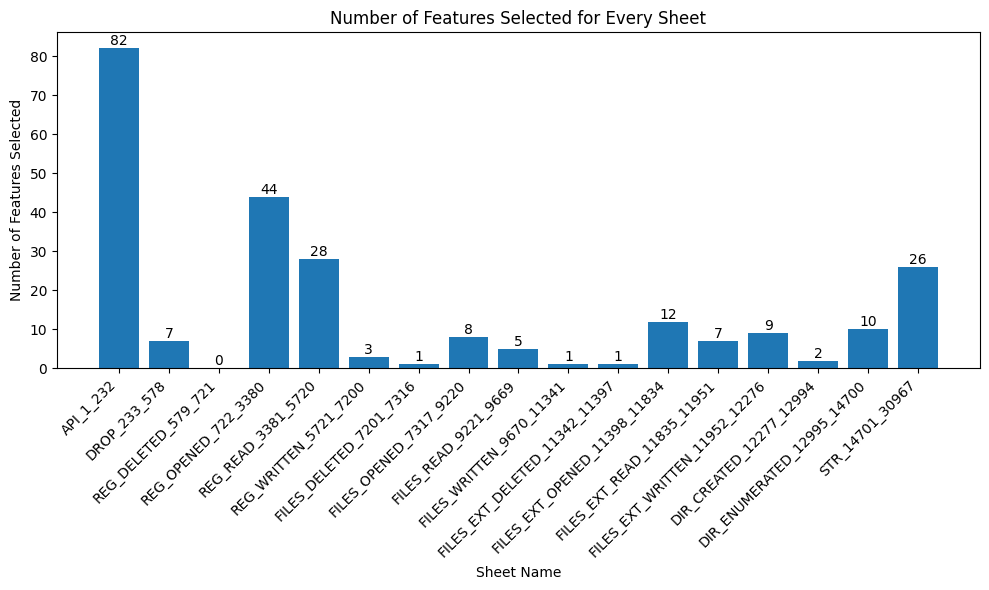

In [ ]:
# prompt: now read the selected_features.xlsx file create a barchart showing the number of features selected for every sheet name

import pandas as pd
import matplotlib.pyplot as plt

# Load the Excel file containing the selected features
excel_file_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/selected_features.xlsx'
feature_counts = {}

# Iterate through the sheets in the Excel file
xls = pd.ExcelFile(excel_file_path)
for sheet_name in xls.sheet_names:
  df = pd.read_excel(excel_file_path, sheet_name=sheet_name)
  feature_counts[sheet_name] = len(df)

# Create a bar chart
plt.figure(figsize=(10, 6))
plt.bar(feature_counts.keys(), feature_counts.values())
plt.xlabel('Sheet Name')
plt.ylabel('Number of Features Selected')
plt.title('Number of Features Selected for Every Sheet')
plt.xticks(rotation=45, ha='right')  # Rotate x-axis labels for better readability

# Add labels above the bars with the count
for i, v in enumerate(feature_counts.values()):
  plt.text(i, v, str(v), ha='center', va='bottom')

plt.tight_layout()
plt.show()

In [ ]:
# prompt: now make a list from reading selected_features.xlsx file which will contain the unique features in ascending order

import pandas as pd

# Load the Excel file containing the selected features
excel_file_path = '/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/selected_features.xlsx'

# Create an empty list to store unique features
unique_features = []

# Iterate through sheets in the Excel file
xls = pd.ExcelFile(excel_file_path)
for sheet_name in xls.sheet_names:
  df = pd.read_excel(excel_file_path, sheet_name=sheet_name)
  features = df['Feature'].tolist()
  unique_features.extend(features)

# Convert to set to remove duplicates and then back to a list
unique_features = sorted(list(set(unique_features)))

# Print the unique features
unique_features


[1,
 2,
 4,
 6,
 8,
 13,
 15,
 18,
 19,
 20,
 21,
 22,
 27,
 30,
 32,
 35,
 38,
 43,
 45,
 48,
 49,
 50,
 55,
 56,
 59,
 60,
 64,
 66,
 67,
 77,
 85,
 86,
 88,
 91,
 92,
 93,
 98,
 101,
 103,
 104,
 105,
 108,
 111,
 112,
 113,
 114,
 115,
 121,
 122,
 128,
 130,
 131,
 132,
 134,
 136,
 137,
 143,
 146,
 148,
 150,
 152,
 156,
 160,
 161,
 164,
 171,
 175,
 185,
 194,
 197,
 198,
 199,
 201,
 203,
 206,
 207,
 209,
 215,
 216,
 222,
 223,
 224,
 259,
 273,
 275,
 415,
 422,
 446,
 459,
 768,
 794,
 832,
 837,
 838,
 869,
 870,
 957,
 980,
 984,
 1074,
 1249,
 1311,
 1337,
 1389,
 1410,
 1411,
 1495,
 1530,
 1666,
 1687,
 2018,
 2069,
 2077,
 2131,
 2193,
 2219,
 2272,
 2298,
 2367,
 2544,
 2676,
 2701,
 2755,
 2807,
 2885,
 2890,
 2941,
 2980,
 2981,
 3058,
 3113,
 3274,
 3354,
 3385,
 3481,
 3482,
 3534,
 3722,
 3730,
 3757,
 3813,
 3823,
 3979,
 3996,
 4071,
 4090,
 4112,
 4152,
 4203,
 4251,
 4289,
 4478,
 4526,
 4674,
 4742,
 4909,
 4917,
 5143,
 5239,
 5379,
 5622,
 5758,
 6393,


In [ ]:
# prompt: convert every item in this unique_features as a string to a make a  list

# Assuming unique_features is defined as in your code
features_string_list = [str(feature) for feature in unique_features]
features_string_list

['1',
 '2',
 '4',
 '6',
 '8',
 '13',
 '15',
 '18',
 '19',
 '20',
 '21',
 '22',
 '27',
 '30',
 '32',
 '35',
 '38',
 '43',
 '45',
 '48',
 '49',
 '50',
 '55',
 '56',
 '59',
 '60',
 '64',
 '66',
 '67',
 '77',
 '85',
 '86',
 '88',
 '91',
 '92',
 '93',
 '98',
 '101',
 '103',
 '104',
 '105',
 '108',
 '111',
 '112',
 '113',
 '114',
 '115',
 '121',
 '122',
 '128',
 '130',
 '131',
 '132',
 '134',
 '136',
 '137',
 '143',
 '146',
 '148',
 '150',
 '152',
 '156',
 '160',
 '161',
 '164',
 '171',
 '175',
 '185',
 '194',
 '197',
 '198',
 '199',
 '201',
 '203',
 '206',
 '207',
 '209',
 '215',
 '216',
 '222',
 '223',
 '224',
 '259',
 '273',
 '275',
 '415',
 '422',
 '446',
 '459',
 '768',
 '794',
 '832',
 '837',
 '838',
 '869',
 '870',
 '957',
 '980',
 '984',
 '1074',
 '1249',
 '1311',
 '1337',
 '1389',
 '1410',
 '1411',
 '1495',
 '1530',
 '1666',
 '1687',
 '2018',
 '2069',
 '2077',
 '2131',
 '2193',
 '2219',
 '2272',
 '2298',
 '2367',
 '2544',
 '2676',
 '2701',
 '2755',
 '2807',
 '2885',
 '2890',
 '2941'

In [ ]:
# prompt: print the length of this list

print(len(string_list))

246


Confusion Matrix:
 [[255  35]
 [ 10 158]]
Accuracy: 0.9017467248908297
Precision: 0.8186528497409327
Recall: 0.9404761904761905
F1-score: 0.8753462603878116
AUC: 0.9757594417077176


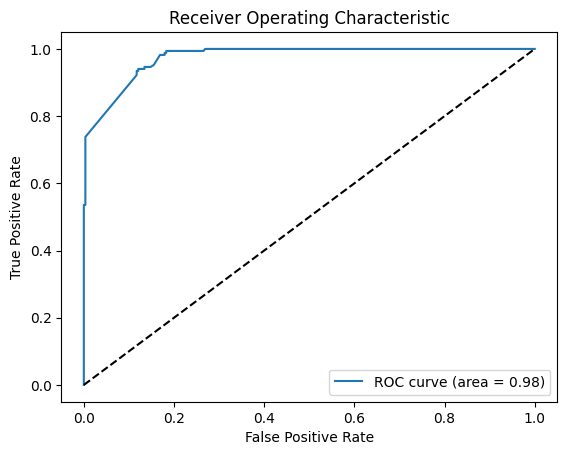

In [ ]:
# prompt: now based upon this unique_features train a model using random forest by reading the dataset from RansomwareData_with_perfect_header.csv file. Remember the ID, Label, Ransomware Family column won't be trained or tested. The target is Label column to detect Ransomware or Safe. calculate confusion matrix, Accuracy, Precision, recall, F1-score, AUC, ROC

# Assuming 'unique_features' is already defined and contains the list of selected features.
# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData_with_perfect_header.csv')

# Select only the features from unique_features
X = df[features_string_list]

# Define the target variable
y = df['Label']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create and train a Random Forest model
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)[:, 1]

# Calculate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
auc = roc_auc_score(y_test, y_pred_proba)

# Calculate ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

# Print the results
print("Confusion Matrix:\n", cm)
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)
print("AUC:", auc)

# Plot ROC curve
plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

Confusion Matrix:
 [[255  35]
 [ 10 158]]
Accuracy: 0.9017467248908297
Precision: 0.8186528497409327
Recall: 0.9404761904761905
F1-score: 0.8753462603878116
AUC: 0.9757594417077176


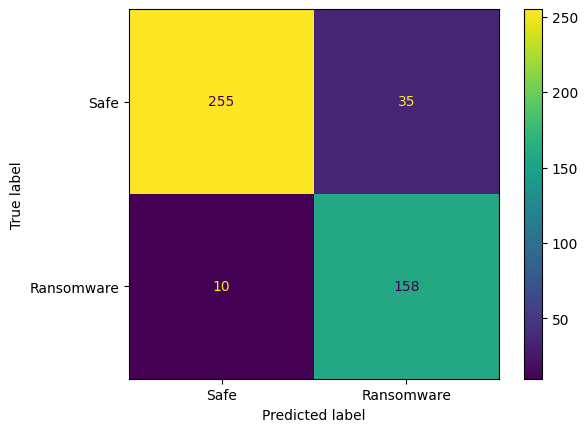

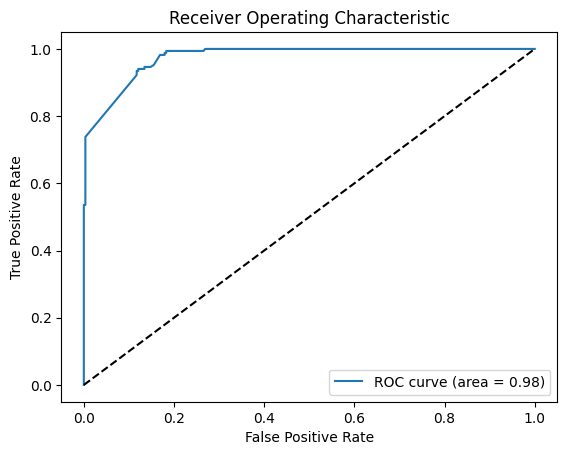

In [ ]:
# prompt: now based upon this features_string_list train a model using random forest by reading the dataset from RansomwareData_with_perfect_header.csv file. Remember the ID, Ransomware Family column won't be trained or tested. The target is Label column to detect Ransomware or Safe. plot confusion matrix, Accuracy, Precision, recall, F1-score, AUC, ROC

# Assuming unique_features is defined as in your code
features_string_list = [str(feature) for feature in unique_features]


# Assuming 'unique_features' is already defined and contains the list of selected features.
# Load the dataset
df = pd.read_csv('/content/drive/MyDrive/Colab Notebooks (Ransom)/ransom2016project/RansomwareData_with_perfect_header.csv')

# Select only the features from unique_features
X = df[features_string_list]

# Define the target variable
y = df['Label']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Create and train a Random Forest model
rf = RandomForestClassifier(random_state=42)
rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred = rf.predict(X_test)
y_pred_proba = rf.predict_proba(X_test)[:, 1]

# Calculate confusion matrix
cm = confusion_matrix(y_test, y_pred)

# Calculate metrics
accuracy = accuracy_score(y_test, y_pred)
precision = precision_score(y_test, y_pred)
recall = recall_score(y_test, y_pred)
f1 = f1_score(y_test, y_pred)
auc = roc_auc_score(y_test, y_pred_proba)

# Calculate ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred_proba)

# Print the results
print("Confusion Matrix:\n", cm)
print("Accuracy:", accuracy)
print("Precision:", precision)
print("Recall:", recall)
print("F1-score:", f1)
print("AUC:", auc)

# Plot confusion matrix
cmd = ConfusionMatrixDisplay(cm, display_labels=['Safe', 'Ransomware'])
cmd.plot()
plt.show()

# Plot ROC curve
plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % auc)
plt.plot([0, 1], [0, 1], 'k--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()